## This code takes a selected images folder (with sub-folders per layer) and the similarity df and creates csv files for the pilot setup
### 1) Find the distractor images per layer for all target images selected 
### 2) Create the experiment csv files so on average there are the same amount of results for all combinations (target - one of the distractors)

In [1]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import random
from PIL import Image
from random import sample
from itertools import chain

from pathlib import Path
from help_functions_preperation import remove_bad_images

In [4]:
project_name='birds'
experiment_name='experiment 1'
model_name='VGG'
target_selection_type = 'best_occurences' #'random','best_occurences' 

PATH_TO_PROJECT=Path.cwd().parent.parent.parent / 'projects' / project_name 
PATH_TO_IMAGES=Path.cwd().parent.parent.parent / 'projects' / project_name / 'raw data'

PATH_TO_TARGET_IMAGES=PATH_TO_PROJECT /experiment_name/ 'experiment resources' / 'images' / 'targets'
if not (PATH_TO_TARGET_IMAGES).exists():
    print('created experiment target images at:\n',PATH_TO_TARGET_IMAGES)
    Path.mkdir(PATH_TO_TARGET_IMAGES)

PATH_TO_ALL_EXPERIMENT_IMAGES=PATH_TO_PROJECT /experiment_name/ 'experiment resources' / 'images' / 'all experiment images'
if not (PATH_TO_ALL_EXPERIMENT_IMAGES).exists():
    print('created experiment all selected images at:\n',PATH_TO_ALL_EXPERIMENT_IMAGES)
    Path.mkdir(PATH_TO_ALL_EXPERIMENT_IMAGES)

PATH_TO_CODE_OUTPUT_FIGURES=PATH_TO_PROJECT /experiment_name/ 'figures and outputs' 
if not (PATH_TO_CODE_OUTPUT_FIGURES).exists():
    print('figures and outputs from this code will be saved in:\n',PATH_TO_CODE_OUTPUT_FIGURES)
    Path.mkdir(PATH_TO_CODE_OUTPUT_FIGURES)

PATH_TO_EXPERIMENT=PATH_TO_PROJECT /experiment_name
PATH_TO_EXPERIMENT_CSV_FILES=PATH_TO_PROJECT /experiment_name/ 'experiment resources' / 'csvs' 


created experiment target images at:
 c:\Users\User\Desktop\visual_memory_project\visual-memory-project\projects\fungi\experiment 2\experiment resources\images\targets
created experiment all selected images at:
 c:\Users\User\Desktop\visual_memory_project\visual-memory-project\projects\fungi\experiment 2\experiment resources\images\all experiment images


In [5]:
similarity_df = pd.read_csv(PATH_TO_PROJECT/f'similarity_{project_name}_all_{model_name}.csv')
similarity_df=similarity_df.replace('.pkl','.jpg',regex=True)

# keeping only relevent data : image names and similarity across levels 
if 'category1' in similarity_df.columns:
    similarity_df = similarity_df.drop(['Unnamed: 0','model','category1','category2'], axis = 1)
else: #we probably loaded the filtered similarity df which doesnt have the model and cat columns... 
    similarity_df = similarity_df.drop(['Unnamed: 0'], axis = 1)

similarity_df

,image1,image2,level_0,level_1,level_2,level_3,level_4,level_5,level_6
0,2237852066-222666.jpg,2237852066-222668.jpg,0.518216,0.424106,0.310927,0.313127,0.476530,0.778986,0.806504
1,2237852066-222666.jpg,2237852112-297894.jpg,0.535670,0.424132,0.298994,0.253748,0.283725,0.455499,0.373751
2,2237852066-222666.jpg,2237852154-74691.jpg,0.481043,0.395120,0.272803,0.192258,0.149006,0.293096,0.332969
3,2237852066-222666.jpg,2237852154-74692.jpg,0.476910,0.387269,0.250685,0.172855,0.165147,0.289664,0.338491
4,2237852066-222666.jpg,2237852217-297922.jpg,0.515995,0.417424,0.292037,0.240059,0.287781,0.503523,0.489363
...,...,...,...,...,...,...,...,...,...
3229606,2238570516-257873.jpg,2874313386-289590.jpg,0.458509,0.367704,0.265565,0.170710,0.173796,0.315299,0.376432
3229607,2238570516-257873.jpg,2874313394-140556.jpg,0.424623,0.359932,0.279039,0.202876,0.196398,0.401485,0.468979
3229608,2238570516-257873.jpg,2874313394-140557.jpg,0.414653,0.358762,0.283340,0.208715,0.171550,0.462952,0.604929
3229609,2238570516-257873.jpg,2874314411-289648.jpg,0.453871,0.385744,0.281145,0.180421,0.165153,0.311043,0.349974


In [6]:
similarity_df.describe()

,level_0,level_1,level_2,level_3,level_4,level_5,level_6
count,3.229611e+06,3.229611e+06,3.229611e+06,3.229611e+06,3.229611e+06,3.229611e+06,3.229611e+06
mean,4.203820e-01,3.648978e-01,2.636668e-01,1.773038e-01,1.560976e-01,3.249538e-01,3.608984e-01
std,4.051037e-02,2.781790e-02,2.454765e-02,3.276411e-02,5.195355e-02,9.072823e-02,1.234469e-01
min,1.715413e-01,1.624846e-01,1.191056e-01,5.459299e-02,1.957872e-02,7.177522e-02,2.380819e-02
25%,3.961779e-01,3.485657e-01,2.489286e-01,1.551587e-01,1.198069e-01,2.590850e-01,2.690611e-01
50%,4.229605e-01,3.662239e-01,2.647394e-01,1.756725e-01,1.493258e-01,3.138516e-01,3.509454e-01
75%,4.472554e-01,3.830910e-01,2.797113e-01,1.972124e-01,1.843993e-01,3.796242e-01,4.427343e-01
max,9.878017e-01,9.792425e-01,9.759383e-01,9.720362e-01,9.668776e-01,9.817359e-01,9.858995e-01


# in this section we select target images :

#### create a table that specifies for each potential target img, how many distractors exceed a specific similarity value in specific layers:   

In [5]:
# specify the levels you want to average over in each sub list. The first sublist ['level_0','level_1'] is the layers 
# we wish to average over to get the lower layers average similarity. The same goes for the second and third sublist. 
levels = [['level_0'],['level_1','level_2','level_3'],['level_4','level_5','level_6']]
#trying a selection that is only based on hiererachy and is evenly spaced within the network: 
levels = [['level_0'],['level_3'],['level_6']] 

In [6]:
if (PATH_TO_PROJECT / 'occurences_requirements.csv').exists():
    print('loaded occurences requirements.csv')
    occurances_requirement=pd.read_csv(PATH_TO_PROJECT / 'occurences_requirements.csv')
    if 'Unnamed: 0' in occurances_requirement.columns:
        occurances_requirement.set_index('Unnamed: 0',inplace=True)     
else:
    #create the occurences matrix: 
    all_images = np.unique(similarity_df[['image1','image2']].values.flatten())
    min_sim_requirements = [[0.5,0.2,0.3],[0.35,0.20,0.35],[0.3,0.3,0.4]]
    #turn into a composition of if statements: 
    occurences_list=[]
    for img in all_images:
        # keeping only relevent rows with target image 
        current_image_df = similarity_df[(similarity_df['image1'] == img) | (similarity_df['image2'] == img)]
        #current_image_df['level_0'] > 
        req1=(current_image_df['level_0']>min_sim_requirements[0][0]) & (current_image_df['level_3']<min_sim_requirements[0][1]) & (current_image_df['level_6']<min_sim_requirements[0][2])
        req2=(current_image_df['level_0']<min_sim_requirements[1][0]) & (current_image_df['level_3']>min_sim_requirements[1][1]) & (current_image_df['level_6']<min_sim_requirements[1][2])
        req3=(current_image_df['level_0']<min_sim_requirements[2][0]) & (current_image_df['level_3']<min_sim_requirements[2][1]) & (current_image_df['level_6']>min_sim_requirements[2][2])
        occurences_list.append([sum(req1),sum(req2),sum(req3)])
        
    pd.DataFrame(columns=['req1','req2','req3'],index=all_images,data=occurences_list)
    occurances_requirement  = pd.DataFrame(columns=['req1','req2','req3'],index=all_images,data=occurences_list)
    occurances_requirement.to_csv(PATH_TO_PROJECT / 'occurences_requirements.csv',index=False)

loaded occurences requirements.csv


#### after ruuning the code and looking at the selected target images , we can add to this list target images that are unwanted and run the code again after deleting the selected targets from the folder 

In [7]:
if project_name == 'birds' and experiment_name == 'experiment 1':
    print('removing')
    #targets 
    bad_images = ['FLAME_BOWERBIRD_1.jpg','PINK_ROBIN_2.jpg','BLUE_THROATED_TOUCANET_1.jpg','GREEN_BROADBILL_3.jpg','TURKEY_VULTURE_4.jpg','CRESTED_CARACARA_5.jpg',
    'CANARY_5.jpg','NORTHERN_GANNET_5.jpg','BANDED_PITA_5.jpg','CHINESE_POND_HERON_4.jpg','EASTERN_WIP_POOR_WILL_4.jpg','SPOONBILL_5.jpg']
    occurances_requirement = remove_bad_images(bad_images,occurances_requirement)

    # distractors 
    for bad_dist in bad_images:
        bad_idx = similarity_df[(similarity_df['image1'] == bad_dist) | (similarity_df['image2'] == bad_dist)].index
        similarity_df = similarity_df.drop(index=bad_idx)

print('The bad images are: ',bad_images)

removing
The bad images are:  ['FLAME_BOWERBIRD_1.jpg', 'PINK_ROBIN_2.jpg', 'BLUE_THROATED_TOUCANET_1.jpg', 'GREEN_BROADBILL_3.jpg', 'TURKEY_VULTURE_4.jpg', 'CRESTED_CARACARA_5.jpg', 'CANARY_5.jpg', 'NORTHERN_GANNET_5.jpg', 'BANDED_PITA_5.jpg', 'CHINESE_POND_HERON_4.jpg', 'EASTERN_WIP_POOR_WILL_4.jpg', 'SPOONBILL_5.jpg']


In [8]:

if target_selection_type=='random':
    #create a subset of images selected from the filtered dataset: 
    np.random.seed(seed=42)
    selected_images=np.random.choice(np.unique(similarity_df[['image1','image2']].values.flatten()), size=60, replace=False)
    for cur_img in selected_images:
        opened_img=Image.open(PATH_TO_IMAGES / cur_img)
        opened_img.save(PATH_TO_TARGET_IMAGES / cur_img)

elif target_selection_type=='best_occurences': 
    
    dynamic_occurances_requirement = occurances_requirement.copy()
    target_images = []

    
    for layer in [2,1,3]: #note that this makes the code first select the best targets based on distactors from the 2nd layer... 

        
        name = 'req'+ str(layer)
        best_target_images_current_layer = dynamic_occurances_requirement[name].nlargest(20)
        dynamic_occurances_requirement = dynamic_occurances_requirement.drop(best_target_images_current_layer.index)
        target_images.append(best_target_images_current_layer.index)


    selected_images = list(chain.from_iterable(target_images))

    for cur_img in selected_images:
        opened_img=Image.open(PATH_TO_IMAGES / cur_img)
        opened_img.save(PATH_TO_TARGET_IMAGES / cur_img)
else: 
    print('selected target type selection method is not a valid method') 

In [10]:
#in this section the user specify the weights for each contrast and the code creates them: 

#create contrast similarities based on the contrast of the similarity of a level (as defined in levels) vs all others:
contrast_similarity_df=pd.DataFrame(columns=['image1','image2']+['contrast_'+str(i) for i in range(len(levels))],index=similarity_df.index)
contrast_similarity_df[['image1','image2']]=similarity_df[['image1','image2']]

all_contrasts_weights=np.array([[1, -0.5, -0.5],[-0.5, 1, -0.5],[-2, -0.5, 1]])

flattened_levels_list = list(chain.from_iterable(levels))
output=np.dot(similarity_df[flattened_levels_list].values,all_contrasts_weights.T)

contrasts_colnames=['contrast_'+str(i) for i in range(len(levels))]
contrast_similarity_df[contrasts_colnames]=output


In [11]:
# these parameters are for the second part of the notetbook where we create
# the actual trials from the experimental setup table
number_subjects_each_image = 10
total_number_levels = 3 
number_target_images = 6

In [12]:
# loading images from sub folders and saving the image names in a list "selected_images"
# the selected images are .jpg but the image names in similarity df are .pkl 
# so we will change all names to pkl
selected_images_paths = list(PATH_TO_TARGET_IMAGES.glob("*.jpg")) #change to */*.jpg if there are subfolders within the selected random
selected_images = [image.name for image in selected_images_paths]

print(f'The total number of selected images is : {len(selected_images)}')
print('The selected images names look like:')
print(selected_images[0:3])





The total number of selected images is : 60
The selected images names look like:
['AFRICAN_PIED_HORNBILL_5.jpg', 'ALPINE_CHOUGH_4.jpg', 'AMERICAN_PIPIT_5.jpg']


# PART 1 : Creating experimental setup table
#### For each selected image, we find the most similar image on average from the specified sublayers. 

In [13]:
#this part selects distractors based on contrast similarity and not just similarity 
layer_matches_0 = []
layer_matches_1 = []
layer_matches_2 = []
selected_matches = []

#extract contrast levels: 
contrast_columns=[colname for colname in contrast_similarity_df.columns if 'contrast' in colname]

for target_image in selected_images:
    # list of other selected images 
    #print('curr target image: ',target_image)
    other_target_images = [x for x in selected_images if x != target_image]

    # keeping only relevent rows with target image 
    current_image_df = contrast_similarity_df[(contrast_similarity_df['image1'] == target_image) | (contrast_similarity_df['image2'] == target_image)]
    
    # removing rows with similarity to other target images 
    for image in other_target_images:
        idx_image1 = current_image_df['image1'] == image
        idx_image2 = current_image_df['image2'] == image
        total_idx = idx_image1 | idx_image2
        current_image_df = current_image_df.drop(total_idx[total_idx == True].index, axis = 0)
        
    # removing rows with similarity to matched images that already have been picked 
    for image in selected_matches:
        idx_image1 = current_image_df['image1'] == image
        idx_image2 = current_image_df['image2'] == image
        total_idx = idx_image1 | idx_image2
        current_image_df = current_image_df.drop(total_idx[total_idx == True].index, axis = 0)
    
    for idx,contrast in enumerate(contrast_columns):
        if contrast=='contrast_1':
            #this part tries to limit the subset to images with rather high mid level similarity 

            temp_similarity_df=similarity_df.loc[current_image_df.index].copy()
            temp_similarity_df=temp_similarity_df.loc[(temp_similarity_df['level_3']>0.14)]
            
            current_image_df=current_image_df.loc[temp_similarity_df.index]
            best_trial = current_image_df.loc[pd.to_numeric(current_image_df[contrast]).idxmax()]            
        # finding max similarity row
        elif contrast=='contrast_2': #the problem is that images are too similar overall - so lets remove all images with a similarity above some value
            
            #this ppart tries to minimize the potential subset of candidate distractor image to have low first level sim and relatively low last level sim
            temp_similarity_df=similarity_df.loc[current_image_df.index].copy()
            temp_similarity_df=temp_similarity_df.loc[(temp_similarity_df['level_0']<=0.38) & (temp_similarity_df['level_6']<0.48) & (temp_similarity_df['level_3']<0.2)]
            
            current_image_df=current_image_df.loc[temp_similarity_df.index]
            best_trial = current_image_df.loc[pd.to_numeric(current_image_df[contrast]).nlargest(n=1).index[-1]]
            #best_trial = current_image_df.loc[current_image_df[contrast].idxmax()]
        else:    
            best_trial = current_image_df.loc[pd.to_numeric(current_image_df[contrast]).idxmax()]


        # saving name of pair image (it can be in one of the two columns)
        if best_trial['image1'] != target_image:
            image_name = best_trial['image1']
        else: 
            image_name = best_trial['image2']
        #print('img name added to selected matches: ',image_name)
        
        selected_matches.append(image_name)
        # appending to relevent list 
        if idx == 0:
            layer_matches_0.append(image_name)
        elif idx == 1:
            layer_matches_1.append(image_name)
        elif idx ==2:
            layer_matches_2.append(image_name)

        # saving the selected image to all images folder 
        image_open_distractor = Image.open(PATH_TO_IMAGES/image_name)
        image_open_target = Image.open(PATH_TO_IMAGES/target_image)
        image_open_distractor.save(PATH_TO_ALL_EXPERIMENT_IMAGES /image_name)
        image_open_target.save(PATH_TO_ALL_EXPERIMENT_IMAGES /target_image)
            
        # dropping matched image so it cant be picked again 
        current_image_df = current_image_df.drop(best_trial.name, axis = 0)

        
experiment_setup_df = pd.DataFrame(list(zip(selected_images,layer_matches_0,layer_matches_1,layer_matches_2)),columns = ['target_image','layer1','layer2','layer3'])
experiment_setup_df.head(5)
experiment_setup_df.to_csv(PATH_TO_EXPERIMENT / 'target_and_distractor_images.csv',index=False)        
    

In [14]:
experiment_setup_df.head(5)

,target_image,layer1,layer2,layer3
0,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg
1,ALPINE_CHOUGH_4.jpg,SNOWY_EGRET_2.jpg,EUROPEAN_GOLDFINCH_3.jpg,BOBOLINK_3.jpg
2,AMERICAN_PIPIT_5.jpg,EMU_2.jpg,GREEN_MAGPIE_1.jpg,HEPATIC_TANAGER_5.jpg
3,ARARIPE_MANAKIN_4.jpg,KIWI_3.jpg,BLACK_VULTURE_1.jpg,BORNEAN_LEAFBIRD_3.jpg
4,ASIAN_CRESTED_IBIS_4.jpg,CANARY_2.jpg,OYSTER_CATCHER_2.jpg,IVORY_GULL_2.jpg


### lets have a look at the pairs: 

In [15]:
def plot_images_with_distractors_for_pilot(experiment_setup_df,PATH_TARGET_IMAGES_FOLDER,PATH_OUTPUTS,PATH_SAVED_IMAGES,ncols=4,nrows=20,im_range=np.arange(0,20),fig_name='default'):
    allimages_list=list(PATH_TARGET_IMAGES_FOLDER.rglob('*.jpg'))
    allimages_list_namesonly=[img.name for img in allimages_list]

    ncols=4
    nrows=60
    # TODO: add a function to look at the selected pairs when you have all images in folder 
    fig,axes=plt.subplots(nrows=nrows,ncols=ncols,figsize=(ncols*2*2,nrows*2*2),sharex=True,sharey=True,gridspec_kw = {'wspace':0.2, 'hspace':0})
    fig.patch.set_facecolor('white')
    cnt=0
    for im_ind in im_range:
        cur_img=experiment_setup_df.iloc[im_ind]['target_image']
        cur_img_jpg=cur_img.replace('.pkl','.jpg')
        im_index=allimages_list_namesonly.index(cur_img_jpg)
        cur_img_jpg=allimages_list[im_index]
        cur_img_jpg_name = cur_img_jpg.name
        l1_img=PATH_TO_IMAGES / experiment_setup_df.iloc[im_ind]['layer1'].replace('.pkl','.jpg')
        l1_img_name = l1_img.name 
        l2_img=PATH_TO_IMAGES / experiment_setup_df.iloc[im_ind]['layer2'].replace('.pkl','.jpg')
        l2_img_name = l2_img.name 
        l3_img=PATH_TO_IMAGES / experiment_setup_df.iloc[im_ind]['layer3'].replace('.pkl','.jpg')
        l3_img_name = l3_img.name 

        cur_img_jpg=Image.open(cur_img_jpg)
     
        axes[cnt,0].imshow(cur_img_jpg)
        axes[cnt,0].set_title(experiment_setup_df.iloc[im_ind]['target_image'].replace('.pkl',''),color='k')
        l1_img=Image.open(l1_img)
        
        axes[cnt,1].imshow(l1_img)
        axes[cnt,1].set_title(experiment_setup_df.iloc[im_ind]['layer1'].replace('.pkl',''),color='k')
        l2_img=Image.open(l2_img)
        
        axes[cnt,2].imshow(l2_img)
        axes[cnt,2].set_title(experiment_setup_df.iloc[im_ind]['layer2'].replace('.pkl',''),color='k')
        l3_img=Image.open(l3_img)
       
        axes[cnt,3].imshow(l3_img)
        axes[cnt,3].set_title(experiment_setup_df.iloc[im_ind]['layer3'].replace('.pkl',''),color='k')

        axes[cnt,0].set_xticks([])
        axes[cnt,0].set_yticks([])

        cnt=cnt+1
    #save the figure: 
    svg_name=fig_name + '.svg'
    png_name=fig_name + '.png'

    fig.savefig(PATH_OUTPUTS / svg_name,format='svg',bbox_inches='tight')
    fig.savefig(PATH_OUTPUTS / png_name,format='png',bbox_inches='tight')
    return fig


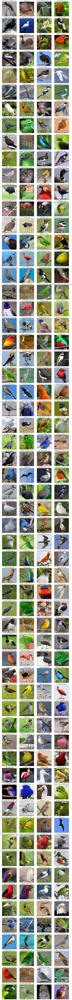

In [16]:
fig1=plot_images_with_distractors_for_pilot(experiment_setup_df,PATH_TO_TARGET_IMAGES,PATH_TO_CODE_OUTPUT_FIGURES,PATH_TO_ALL_EXPERIMENT_IMAGES,ncols=4,nrows=60,im_range=np.arange(0,60),fig_name='all_layers_contrasted')

In [17]:
#create a dataframe that includes both the contrast values and the original similarity values. 
experiment_setup_df.head(10)
exp_layers=[colname for colname in experiment_setup_df.columns if 'layer' in colname]

experiment_setup_similarities_df=pd.DataFrame(columns=list(similarity_df.columns)+['distractor_level'])
for i in range(len(experiment_setup_df)):
    cur_target_img=experiment_setup_df['target_image'].iloc[i]
    for distractor_level,layer in enumerate(exp_layers):
        #get the relevant row for the current distractor and target images: 
        cur_distractor=experiment_setup_df[layer].iloc[i]
        relevant_sim_row=similarity_df[((similarity_df['image1']==cur_target_img) & (similarity_df['image2']==cur_distractor)) | 
        (similarity_df['image2']==cur_target_img) & (similarity_df['image1']==cur_distractor)].copy()
        relevant_sim_row['distractor_level']=distractor_level
        experiment_setup_similarities_df=pd.concat([experiment_setup_similarities_df,relevant_sim_row],axis=0)

experiment_setup_similarities_df.to_csv(PATH_TO_EXPERIMENT / 'target_and_distractor_images_with_similarity_values.csv',index=False)        


In [18]:
sim_levels_colnames=[colname for colname in experiment_setup_similarities_df.columns if 'level' in colname and not 'distractor'
in colname]
experiment_setup_similarities_df['mean_similarity']=experiment_setup_similarities_df[sim_levels_colnames].mean(axis=1)
experiment_setup_similarities_df.groupby('distractor_level').aggregate({'mean_similarity':['mean','std']})

mean_similarity          
                            mean       std
distractor_level                          
0                       0.229513  0.044638
1                       0.252641  0.043088
2                       0.276556  0.020923

                   level_0   level_1   level_2   level_3   level_4   level_5  \
distractor_level                                                               
0                 0.459907  0.320941  0.205172  0.137745  0.126811  0.186107   
1                 0.295206  0.303025  0.240904  0.245857  0.255481  0.229419   
2                 0.247719  0.266065  0.191278  0.155369  0.232626  0.396701   

                   level_6  
distractor_level            
0                 0.169909  
1                 0.198599  
2                 0.446133  


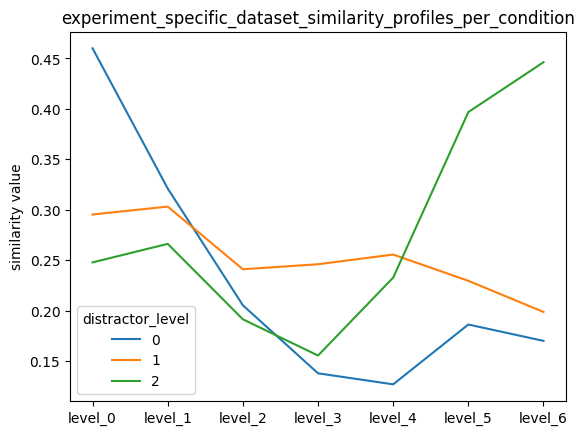

In [19]:
sim_level_colnames=[colname for colname in experiment_setup_similarities_df.columns if 'level' in colname
 and not 'distractor' in colname]
experiment_setup_similarities_df[sim_level_colnames]=experiment_setup_similarities_df[sim_level_colnames].astype('float64')

print(experiment_setup_similarities_df[[col for col in experiment_setup_similarities_df.columns if 'level' in col]].groupby('distractor_level').mean())

experiment_setup_similarities_df[[col for col in experiment_setup_similarities_df.columns if 'level' in col]].groupby('distractor_level').mean().T.plot()

plt.title('experiment_specific_dataset_similarity_profiles_per_condition')
plt.ylabel('similarity value')
plt.savefig(PATH_TO_CODE_OUTPUT_FIGURES/'experiment_specific_dataset_similarity_profiles_per_condition.svg')

['level_0', 'level_1', 'level_2', 'level_3', 'level_4', 'level_5', 'level_6']
          level_0   level_1   level_2   level_3   level_4   level_5   level_6
level_0  1.000000  0.695338  0.173822 -0.145614 -0.358646 -0.402768 -0.406335
level_1  0.695338  1.000000  0.625672  0.251696 -0.073828 -0.321274 -0.378266
level_2  0.173822  0.625672  1.000000  0.830907  0.408307 -0.136190 -0.232740
level_3 -0.145614  0.251696  0.830907  1.000000  0.700029  0.067873 -0.059961
level_4 -0.358646 -0.073828  0.408307  0.700029  1.000000  0.567774  0.431347
level_5 -0.402768 -0.321274 -0.136190  0.067873  0.567774  1.000000  0.944911
level_6 -0.406335 -0.378266 -0.232740 -0.059961  0.431347  0.944911  1.000000


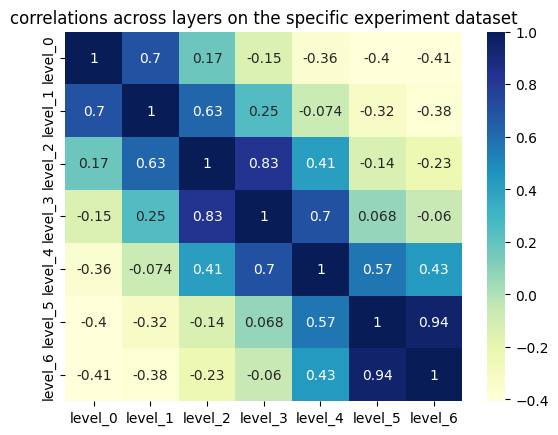

In [20]:

import seaborn as sns
sim_level_colnames=[colname for colname in experiment_setup_similarities_df.columns if 'level' in colname
 and not 'distractor' in colname]
experiment_setup_similarities_df[sim_level_colnames]=experiment_setup_similarities_df[sim_level_colnames].astype('float64')
print(sim_level_colnames)
print(experiment_setup_similarities_df[sim_level_colnames].corr())
dataplot = sns.heatmap(experiment_setup_similarities_df[sim_level_colnames].corr(), cmap="YlGnBu", annot=True)
# displaying heatmap


plt.title('correlations across layers on the specific experiment dataset')
plt.savefig(PATH_TO_CODE_OUTPUT_FIGURES/'correlation_across_layers.svg')
plt.show()

# PART 2 : Creating the experiment setup trials from table

In [21]:
experiment_setup_df_dup = pd.DataFrame(np.repeat(experiment_setup_df.values, number_subjects_each_image*total_number_levels, axis=0),columns = experiment_setup_df.columns)

In [22]:
experiment_setup_df_dup = experiment_setup_df_dup.replace('.pkl','.jpg',regex=True)
experiment_setup_df_dup.head(6)

,target_image,layer1,layer2,layer3
0,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg
1,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg
2,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg
3,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg
4,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg
5,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg


In [23]:
targets_dataframe=pd.DataFrame(experiment_setup_df_dup['target_image']).drop_duplicates().reset_index()
layer1_dataframe=pd.DataFrame(experiment_setup_df_dup['layer1']).drop_duplicates().reset_index()
layer1_dataframe['counter']=0
layer1_dataframe['overall_counter']=0
layer2_dataframe=pd.DataFrame(experiment_setup_df_dup['layer2']).drop_duplicates().reset_index()
layer2_dataframe['counter']=0
layer2_dataframe['overall_counter']=0
layer3_dataframe=pd.DataFrame(experiment_setup_df_dup['layer3']).drop_duplicates().reset_index()
layer3_dataframe['counter']=0
layer3_dataframe['overall_counter']=0

layer_dataframe=pd.DataFrame(experiment_setup_df_dup).drop_duplicates().reset_index()
layer_dataframe['counter']=0
layer_dataframe['overall_counter_layer1']=0
layer_dataframe['overall_counter_layer2']=0
layer_dataframe['overall_counter_layer3']=0

layer_dataframe=layer_dataframe.drop_duplicates().reset_index().drop(columns=['level_0','index'])
layer_dataframe

,target_image,layer1,layer2,layer3,counter,overall_counter_layer1,overall_counter_layer2,overall_counter_layer3
0,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg,0,0,0,0
1,ALPINE_CHOUGH_4.jpg,SNOWY_EGRET_2.jpg,EUROPEAN_GOLDFINCH_3.jpg,BOBOLINK_3.jpg,0,0,0,0
2,AMERICAN_PIPIT_5.jpg,EMU_2.jpg,GREEN_MAGPIE_1.jpg,HEPATIC_TANAGER_5.jpg,0,0,0,0
3,ARARIPE_MANAKIN_4.jpg,KIWI_3.jpg,BLACK_VULTURE_1.jpg,BORNEAN_LEAFBIRD_3.jpg,0,0,0,0
4,ASIAN_CRESTED_IBIS_4.jpg,CANARY_2.jpg,OYSTER_CATCHER_2.jpg,IVORY_GULL_2.jpg,0,0,0,0
5,ASIAN_DOLLARD_BIRD_2.jpg,ALBATROSS_2.jpg,LOGGERHEAD_SHRIKE_4.jpg,VIOLET_GREEN_SWALLOW_4.jpg,0,0,0,0
6,BALI_STARLING_1.jpg,CAPE_LONGCLAW_5.jpg,PURPLE_FINCH_2.jpg,IBERIAN_MAGPIE_1.jpg,0,0,0,0
7,BREWERS_BLACKBIRD_3.jpg,GUINEA_TURACO_3.jpg,GOLDEN_CHEEKED_WARBLER_3.jpg,CAPE_LONGCLAW_2.jpg,0,0,0,0
8,BROWN_NOODY_3.jpg,PEACOCK_2.jpg,SPANGLED_COTINGA_4.jpg,GUINEA_TURACO_5.jpg,0,0,0,0
9,BROWN_THRASHER_3.jpg,DOUBLE_EYED_FIG_PARROT_3.jpg,OYSTER_CATCHER_4.jpg,BLACK_BAZA_4.jpg,0,0,0,0


In [24]:
"""regular pilot params: 
apearances_per_image=13
min_required_apearances_per_image=10

number_of_subjects=35
min_required_subjects=31
images_per_subject_per_layer=20

iteration_counter=0
stop_trying_after_num_iterations=10"""


apearances_per_image=15*2 #this defines how many of repetition for each unique target/distractor pairs we aim for: 
min_required_apearances_per_image=10*2 #this is the minimum we accept as a "balanced" set

number_of_subjects=35*2 #how many participants we would want to have
min_required_subjects=31*2 #the minimum amount of participants we can accept as "Balanced"
images_per_subject_per_layer=20 #how many distractrors from each layer (3 layers) are seen by a participant

iteration_counter=0
stop_trying_after_num_iterations=10

iterations_sub_ind_info=[]
do_loop=True

while do_loop:
    iteration_counter=iteration_counter+1
    all_iteration_subs_df_list=[]
    try:
        for subject in range(number_of_subjects): 
            sub_df=pd.DataFrame()
            for cur_layer in np.arange(1,4):
                for i in range(images_per_subject_per_layer): 
                    subline=pd.DataFrame()
                    optional_images=layer_dataframe
                    sampling_weights= 1-(layer_dataframe[['overall_counter_layer'+str(cur_layer)]]/apearances_per_image)
                    sampling_weights[layer_dataframe['counter']==1]=0
                    sampling_weights=sampling_weights/np.sum(sampling_weights)
                    sampled_img=np.random.choice(optional_images['layer'+str(cur_layer)],size=1,replace=False,p = sampling_weights.values.flatten())
                    img_index=np.where(optional_images['layer'+str(cur_layer)].values==sampled_img)[0]
                    #print(sampled_img)
                    subline['target_image']=targets_dataframe.loc[img_index]['target_image']
                    subline['pair']=sampled_img[0]
                    subline['layer']=cur_layer
                    layer_dataframe.loc[img_index,'counter']=layer_dataframe.loc[img_index,'counter']+1
                    #print(layer1_dataframe)
                    layer_dataframe.loc[img_index,['overall_counter_layer'+str(cur_layer)]]=layer_dataframe.loc[img_index,['overall_counter_layer'+str(cur_layer)]]+1
                    #add to subject matrix: 
                    sub_df=pd.concat([sub_df,subline],axis=0)
            layer_dataframe['counter']=0
            all_iteration_subs_df_list.append(sub_df)
        do_loop=False
    except:
        print(f'iteration {iteration_counter}, failed, trying again (subject: {subject} image selection ind {i}')
        iterations_sub_ind_info.append((subject,i))
        if (iteration_counter==stop_trying_after_num_iterations) or ((subject>=min_required_subjects) and (i>min_required_apearances_per_image)):
            print('focred stopped')
            do_loop=False   
        else:
        #if failed, reset the counter dataframe: 
            layer_dataframe['counter']=0
            layer_dataframe['overall_counter_layer1']=0
            layer_dataframe['overall_counter_layer2']=0
            layer_dataframe['overall_counter_layer3']=0


In [25]:
layer_dataframe

,target_image,layer1,layer2,layer3,counter,overall_counter_layer1,overall_counter_layer2,overall_counter_layer3
0,AFRICAN_PIED_HORNBILL_5.jpg,KIWI_4.jpg,ALEXANDRINE_PARAKEET_1.jpg,CAPUCHINBIRD_2.jpg,0,26,20,24
1,ALPINE_CHOUGH_4.jpg,SNOWY_EGRET_2.jpg,EUROPEAN_GOLDFINCH_3.jpg,BOBOLINK_3.jpg,0,24,19,27
2,AMERICAN_PIPIT_5.jpg,EMU_2.jpg,GREEN_MAGPIE_1.jpg,HEPATIC_TANAGER_5.jpg,0,29,20,21
3,ARARIPE_MANAKIN_4.jpg,KIWI_3.jpg,BLACK_VULTURE_1.jpg,BORNEAN_LEAFBIRD_3.jpg,0,21,24,25
4,ASIAN_CRESTED_IBIS_4.jpg,CANARY_2.jpg,OYSTER_CATCHER_2.jpg,IVORY_GULL_2.jpg,0,19,26,25
5,ASIAN_DOLLARD_BIRD_2.jpg,ALBATROSS_2.jpg,LOGGERHEAD_SHRIKE_4.jpg,VIOLET_GREEN_SWALLOW_4.jpg,0,26,20,24
6,BALI_STARLING_1.jpg,CAPE_LONGCLAW_5.jpg,PURPLE_FINCH_2.jpg,IBERIAN_MAGPIE_1.jpg,0,22,23,25
7,BREWERS_BLACKBIRD_3.jpg,GUINEA_TURACO_3.jpg,GOLDEN_CHEEKED_WARBLER_3.jpg,CAPE_LONGCLAW_2.jpg,0,24,25,21
8,BROWN_NOODY_3.jpg,PEACOCK_2.jpg,SPANGLED_COTINGA_4.jpg,GUINEA_TURACO_5.jpg,0,26,25,19
9,BROWN_THRASHER_3.jpg,DOUBLE_EYED_FIG_PARROT_3.jpg,OYSTER_CATCHER_4.jpg,BLACK_BAZA_4.jpg,0,20,22,28


In [26]:
for sub in range(len(all_iteration_subs_df_list)-1):
    curr_sub_df=all_iteration_subs_df_list[sub]
    curr_sub_df = curr_sub_df.sample(frac=1).reset_index(drop=True)
    curr_sub_df['correct']=None

    #create the test.csv for this participants: 
    correct_column = []
    test_sub_df=curr_sub_df.copy()
    for row in test_sub_df.T:
        random_pick = np.random.randint(0,2)

        if random_pick == 0:
            correct_column.append('left')
        elif random_pick == 1:
            test_sub_df.loc[row,['target_image','pair']] = test_sub_df.loc[row,['pair','target_image']].values

            correct_column.append('right')

    test_sub_df['correct'] = correct_column
    test_sub_df.columns = ['image1', 'image2', 'layer', 'correct']
    test_sub_df = test_sub_df.sample(frac=1).reset_index(drop=True)
    test_sub_df.to_csv(PATH_TO_EXPERIMENT_CSV_FILES / Path(f'sub_test{sub}.csv'), index=False)

    #add manipulation check in random positions (left right arrows) 
    top_index=[10,20,30,40,50]
    random_noise=[-4,-3,-2,-1,0,1,2,3,4]
    arrows=['right.jpg','left.jpg']
    for arrow in range(len(top_index)):
        chosen_noise=random.choice(random_noise)
        chosen_arrow=random.choice(arrows)
        chosen_idx=top_index[arrow]+chosen_noise - 0.5
        correct=chosen_arrow.split('.')[0]

        new_row = [chosen_arrow,None,None,correct]

        curr_sub_df.loc[chosen_idx]=new_row
        curr_sub_df=curr_sub_df.sort_index().reset_index(drop=True)

    curr_sub_df.to_csv(PATH_TO_EXPERIMENT_CSV_FILES / f'sub_encoding{sub}.csv',index=False)    